In [1]:
import numpy as np
import cv2
from skimage.transform import resize
import matplotlib.pyplot as plt
import keras.preprocessing.image as image_processor
from keras.applications import VGG16
from keras import backend as K
from keras.models import Model

Using TensorFlow backend.


In [17]:
model = VGG16(weights='imagenet',include_top=False, input_shape=(500,500,3))
model.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         (None, 500, 500, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 500, 500, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 500, 500, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 250, 250, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 250, 250, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 250, 250, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 125, 125, 128)     0     

In [21]:
def to_image(image):
    #make the image nice
    img = np.copy(image)
    img -= img.mean()
    img /= (img.std() + 1e-5)
    img *= 0.1
    img += 0.5
    
    img = np.clip(img, 0, 1)
    img *= 255
    return img.astype('uint8')

def generate_pattern_quick(layer_name, filter_index, steps=100):
    size = 500 #hardcoded
    #get the layer
    layer_output = model.get_layer(layer_name).output
    #let's take mean as the loss
    loss = K.mean(layer_output[:, :, :, filter_index])
    #gradient of the image with respect to this loss
    grads = K.gradients(loss, model.input)[0]
    #normalization
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)
    
    iterate = K.function([model.input], [loss, grads])
    input_img_data = np.random.random((1, size, size, 3))*20 + 128.
    
    step = 1.
    total_gradient_steps = steps
    for j in range(total_gradient_steps):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step
        step = step * 0.99
    return to_image(input_img_data[0])

def generate_pattern(layer_name, filter_index):
    size = 500 #hardcoded
    #get the layer
    layer_output = model.get_layer(layer_name).output
    #let's take mean as the loss
    loss = K.mean(layer_output[:, :, :, filter_index])
    #gradient of the image with respect to this loss
    grads = K.gradients(loss, model.input)[0]
    #normalization
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)
    
    iterate = K.function([model.input], [loss, grads])
    input_img_data = np.random.random((1, size, size, 3))*20 + 128.
    
    total_epochs = 5
    total_gradient_steps = 50
    step = 1.
    for i in range(total_epochs):
        for j in range(total_gradient_steps):
            loss_value, grads_value = iterate([input_img_data])
            input_img_data += grads_value * step
            step = step *0.99
        #zoom a bit into image
        for k in range(3):
            temp = resize(input_img_data[0,:,:,k], (600,600))
            input_img_data[0,:,:,k] = temp[50:-50,50:-50]
        
    for j in range(total_gradient_steps):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value 
    img = to_image(input_img_data[0])
    return img

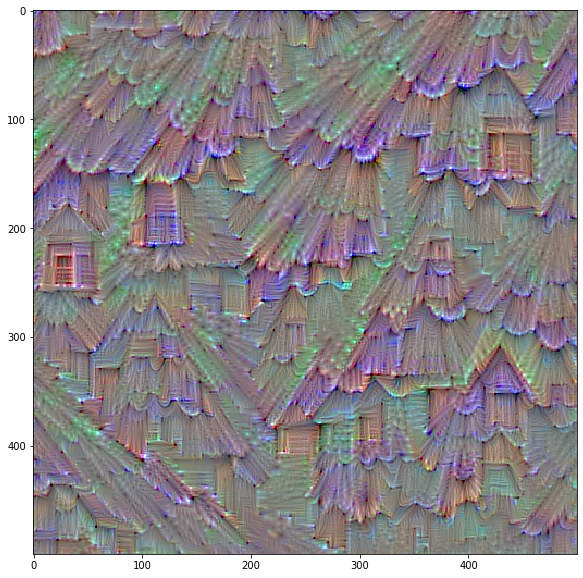

In [23]:
img = generate_pattern('block5_conv2', 2)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

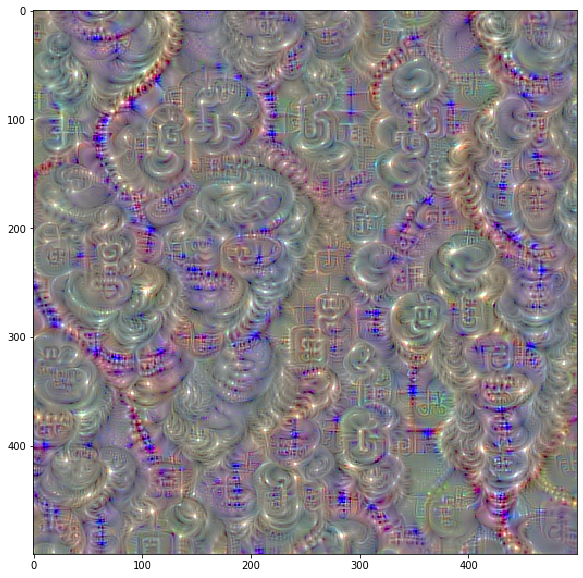

In [25]:
img = generate_pattern('block5_conv2', 10)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

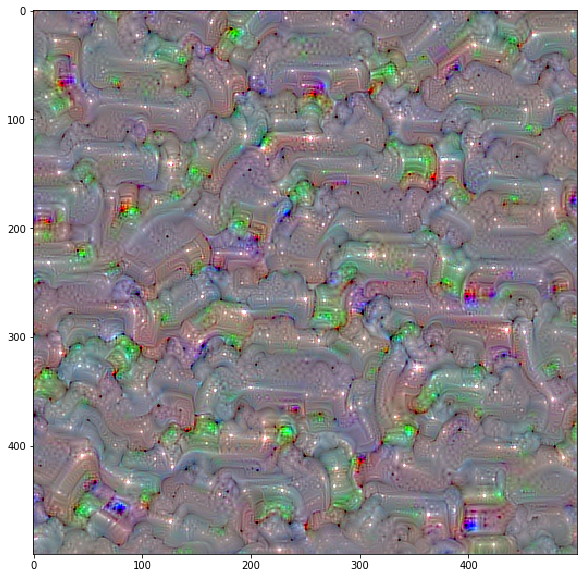

In [31]:
img = generate_pattern('block5_conv2', 50)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

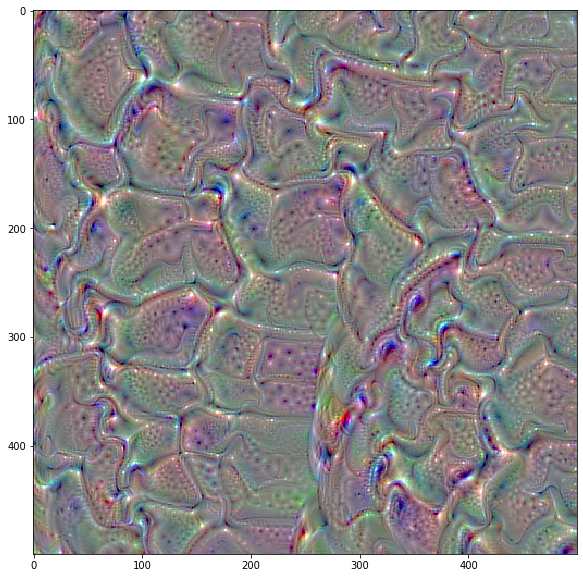

In [34]:
img = generate_pattern('block5_conv2', 15)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

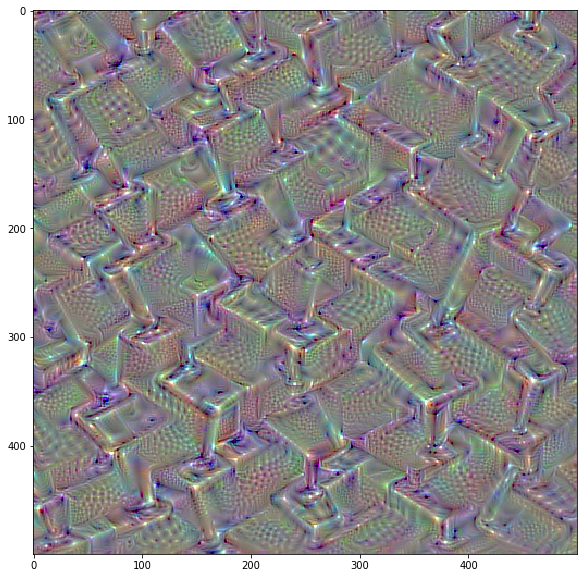

In [35]:
img = generate_pattern('block5_conv2', 18)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

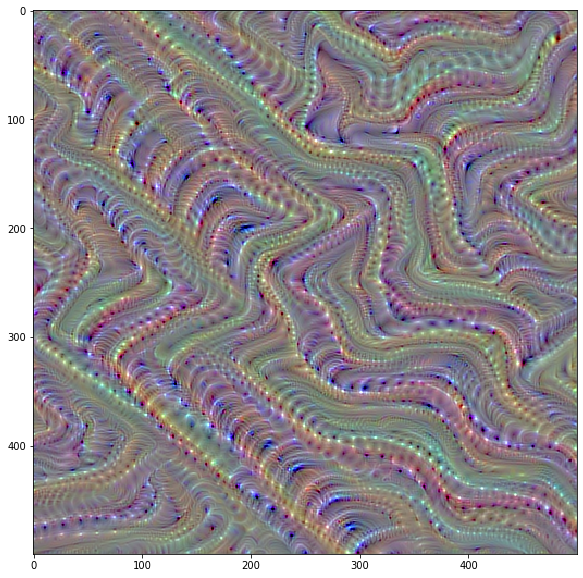

In [36]:
img = generate_pattern('block5_conv2', 61)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

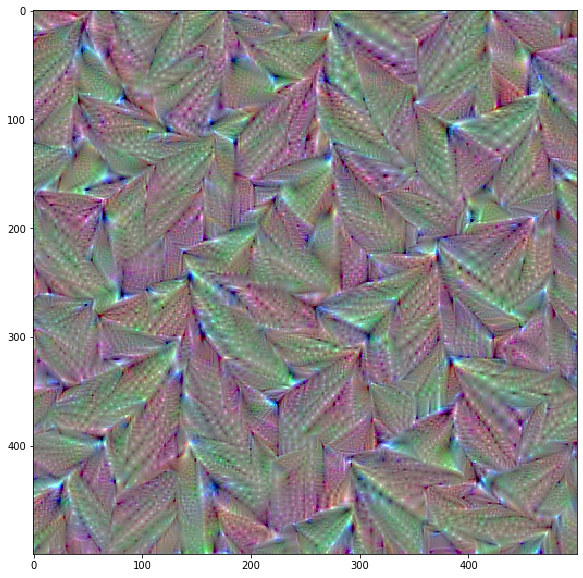

In [39]:
img = generate_pattern('block5_conv2', 64)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

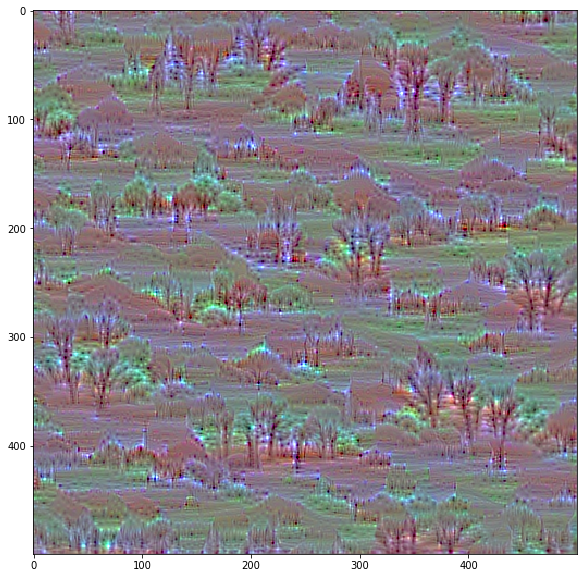

In [44]:
img = generate_pattern('block5_conv1', 42)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

### Definitely trees!!

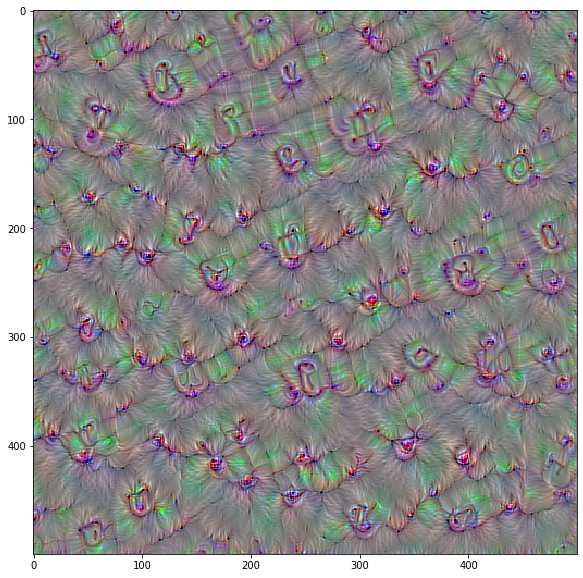

In [45]:
img = generate_pattern('block5_conv1', 96)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

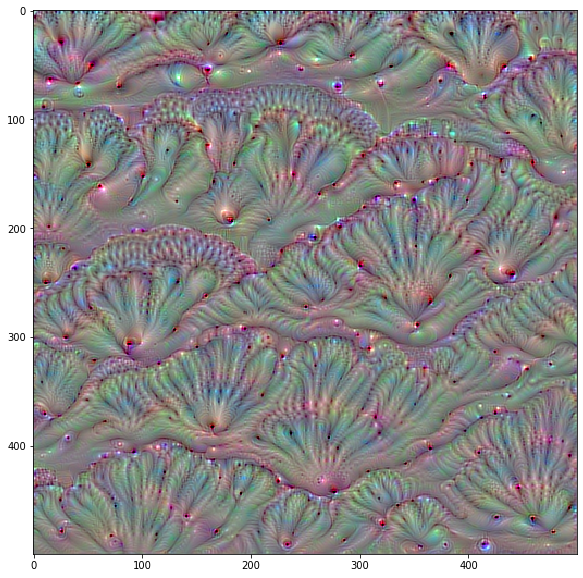

In [46]:
img = generate_pattern('block5_conv1', 99)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

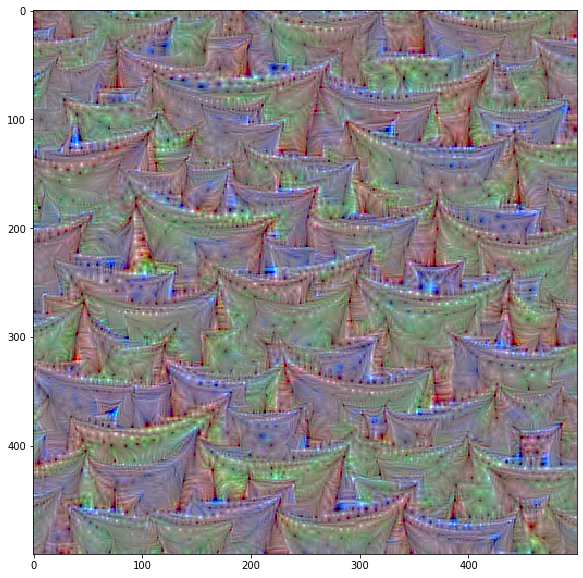

In [49]:
img = generate_pattern('block5_conv1', 128)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

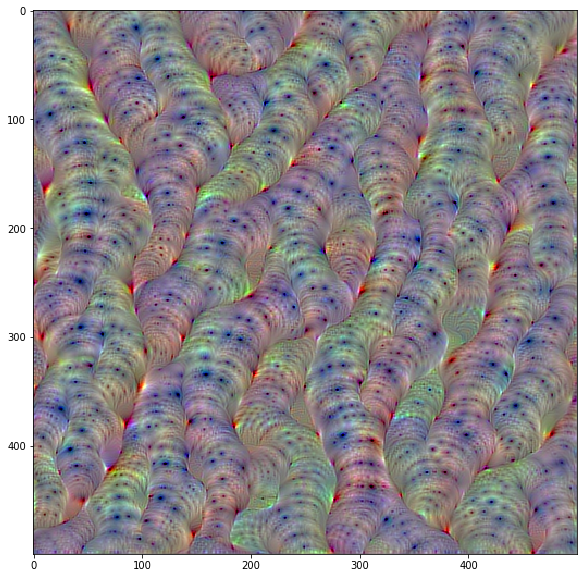

In [50]:
img = generate_pattern('block5_conv1', 324)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

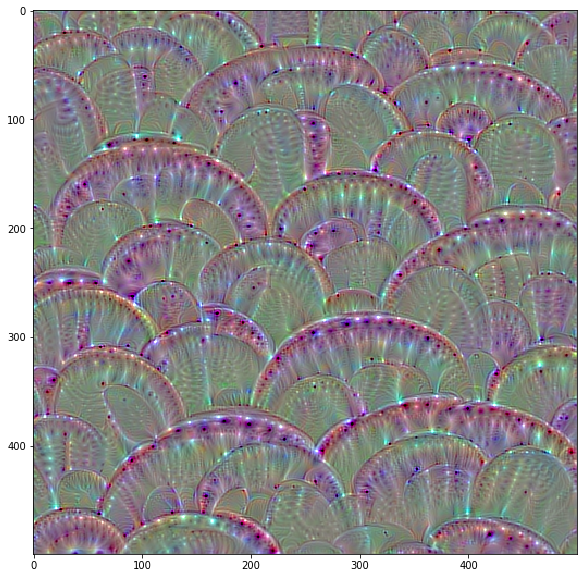

In [54]:
img = generate_pattern('block5_conv1', 16)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

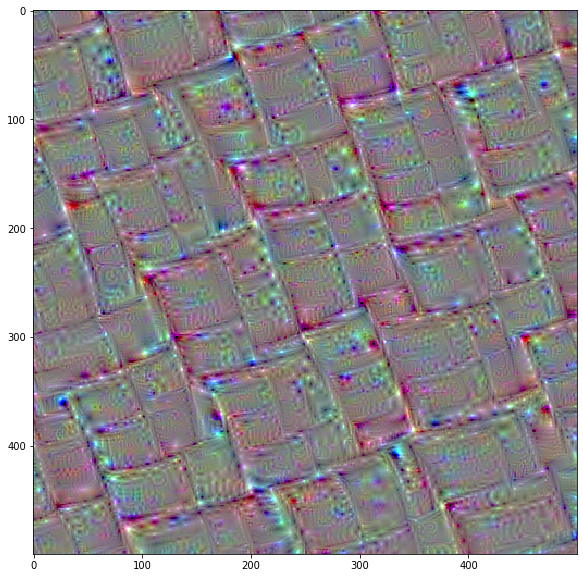

In [58]:
img = generate_pattern('block5_conv1', 47)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

### Pillows?

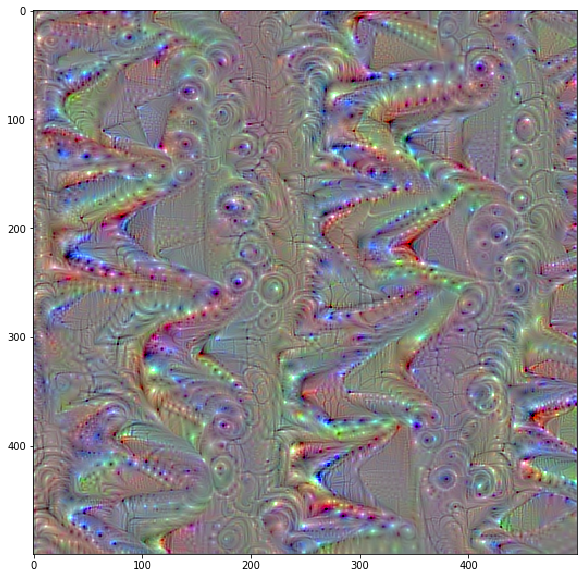

In [59]:
img = generate_pattern('block5_conv1', 55)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

### Cat ears?

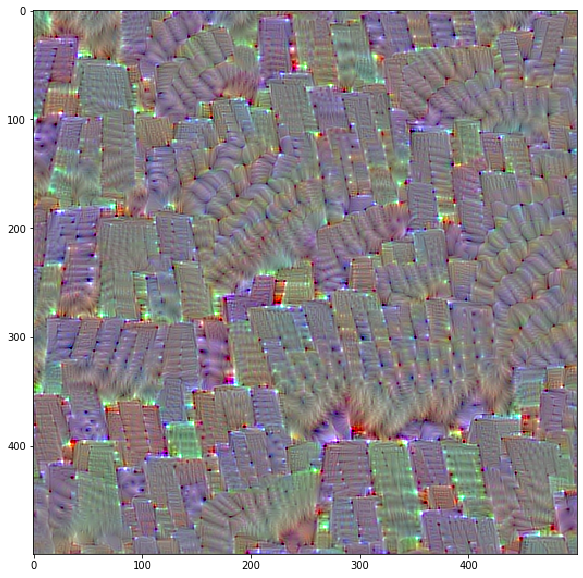

In [62]:
img = generate_pattern('block5_conv1', 155)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

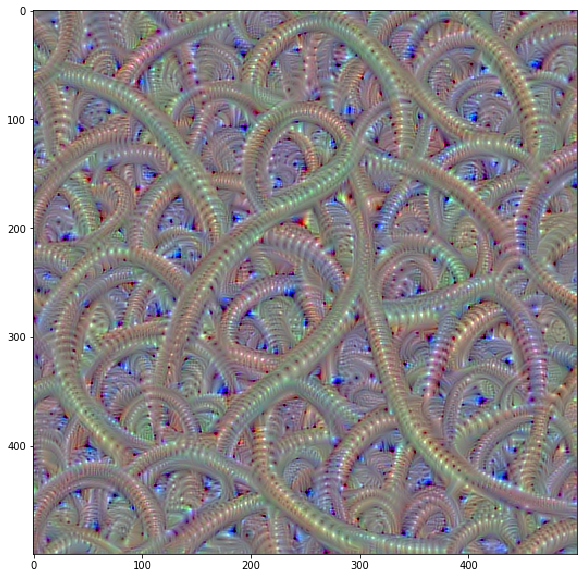

In [68]:
img = generate_pattern('block5_conv1', 232)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

### Pipes?

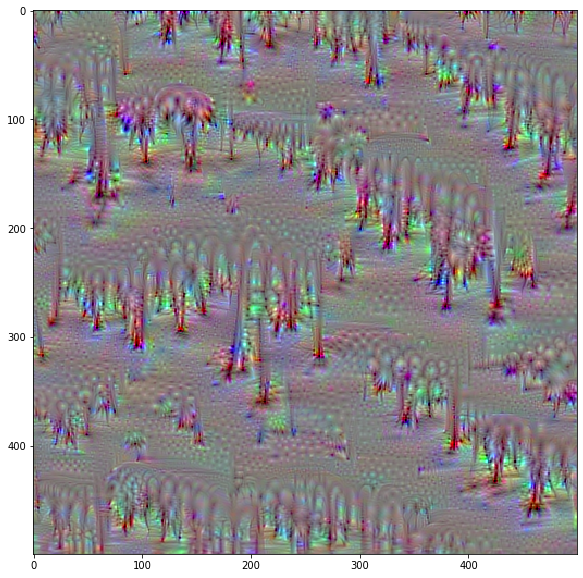

In [73]:
img = generate_pattern('block5_conv1', 336)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

### Trees?

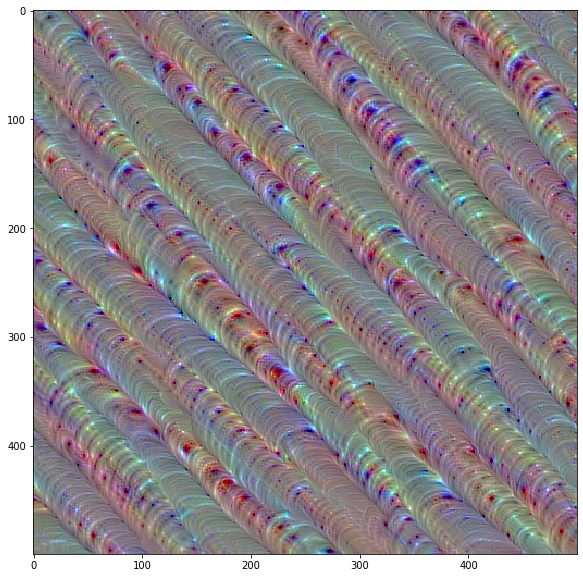

In [77]:
img = generate_pattern('block5_conv1', 111)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

### Scaled skin?

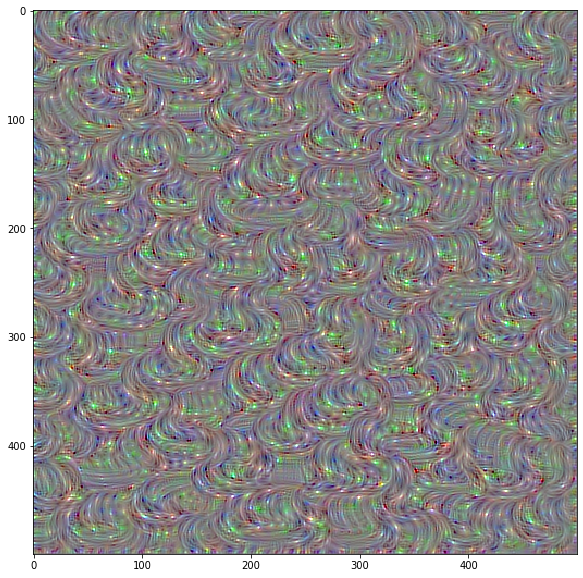

In [80]:
img = generate_pattern('block5_conv1', 274)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

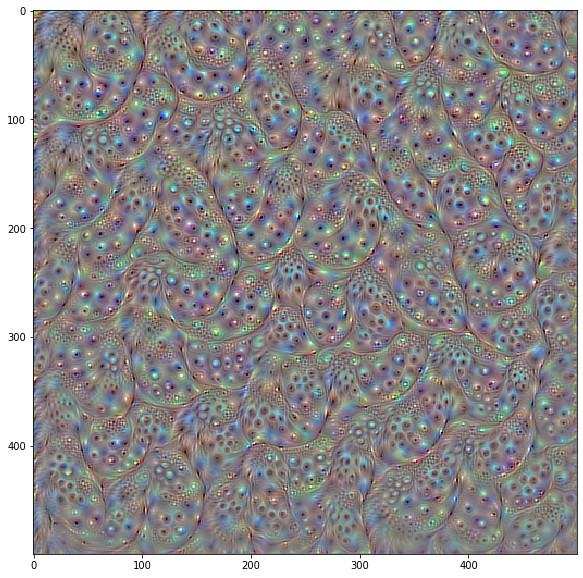

In [83]:
img = generate_pattern('block5_conv1', 277)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

### ?

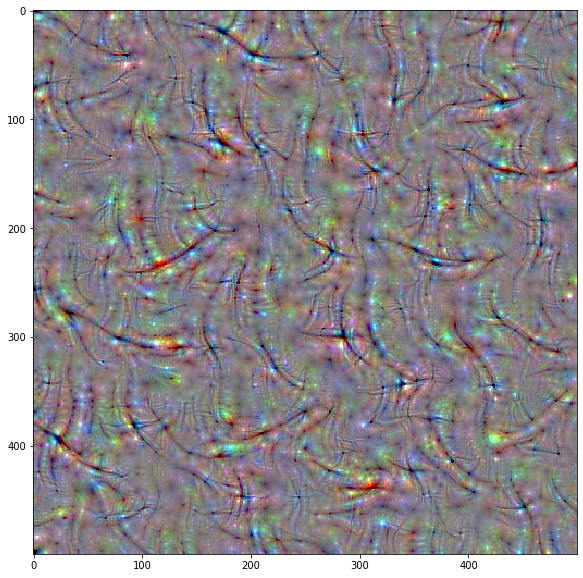

In [84]:
img = generate_pattern('block5_conv1', 278)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

### Edges curved?

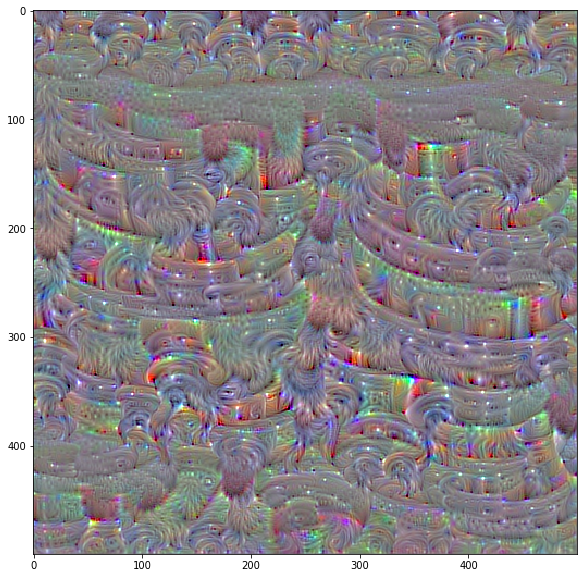

In [86]:
img = generate_pattern('block5_conv1', 280)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

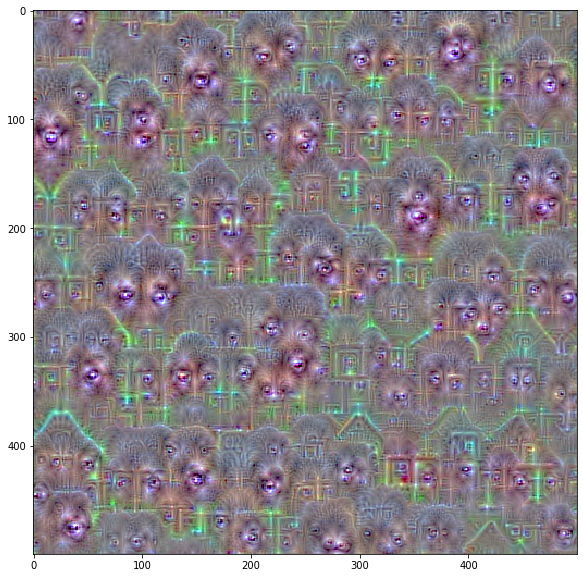

In [88]:
img = generate_pattern('block5_conv1', 285)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

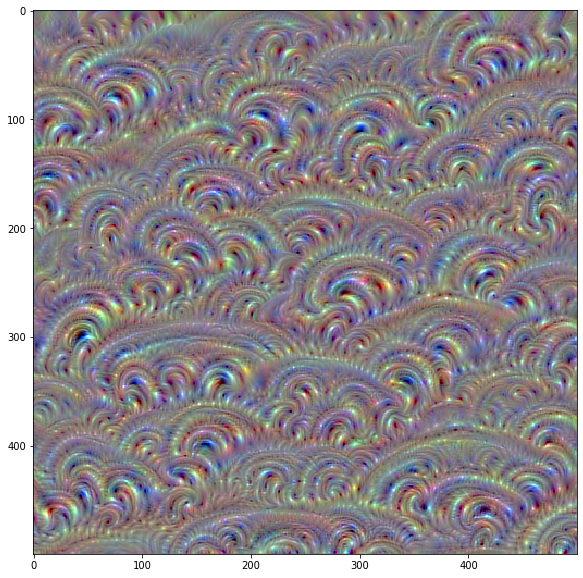

In [90]:
img = generate_pattern('block5_conv1', 292)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

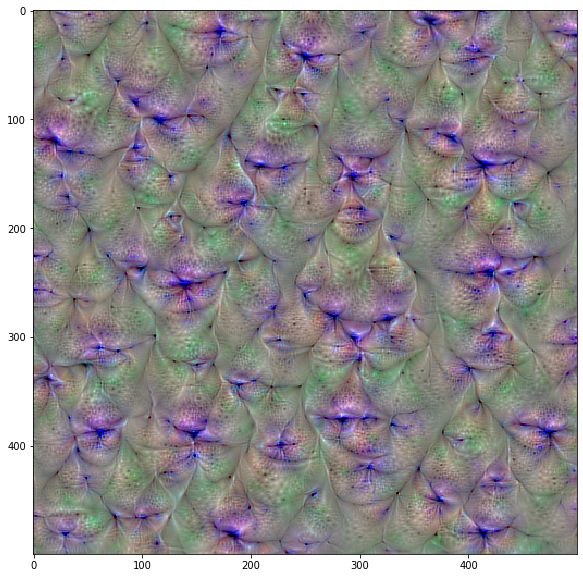

In [91]:
img = generate_pattern('block5_conv1', 300)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

### Animal nose ?

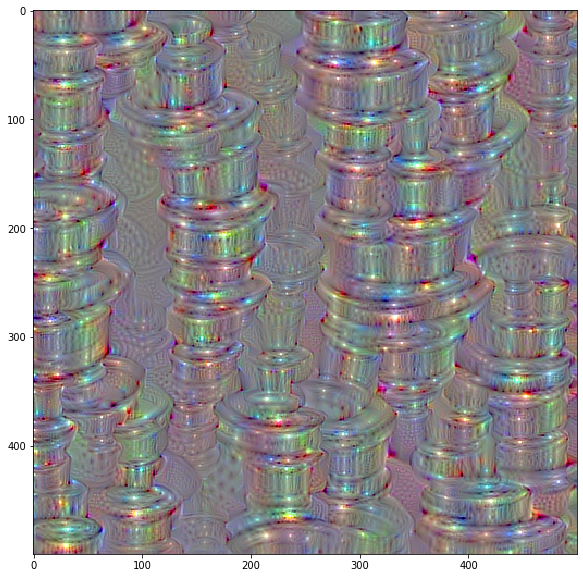

In [92]:
img = generate_pattern('block5_conv1', 301)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

### Containers?

# BEAUTIFUL!!!!!!!!!